In [3]:
import librosa
import matplotlib.pyplot as plt
# Instead of %matplotlib inline we use %matplotlib notebook this time.
# This allows for more interactive examination of graphs, which will be useful
# as you will manually inspect the results curves.
%matplotlib notebook
from scipy.signal import resample
from scipy.signal import find_peaks_cwt
from scipy.spatial import distance

from IPython.display import Audio
import cv2
import os
import datetime
import numpy as np
import os
import urllib
import IPython
import matplotlib.pyplot as plt
import librosa.display

In [4]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
from bokeh.models import HoverTool

In [5]:
AUDIO_PATH =  os.path.join('/home/xin/Downloads/MMSR_Project/', 'nba.mp3')
audio_signal, sample_rate = librosa.core.load(AUDIO_PATH)

In [6]:
# Audio duration (in seconds).
number_of_audio_samples = len(audio_signal)
audio_duration = float(number_of_audio_samples / float(sample_rate))

print('sample rate: %d' % sample_rate)
print('number of samples: %d' % number_of_audio_samples)
print('duration: %s' % datetime.timedelta(seconds=audio_duration))

sample rate: 22050
number of samples: 36370944
duration: 0:27:29.475918


In [7]:
print(sample_rate)

22050


In [21]:
# show the audio
IPython.display.display(IPython.display.Audio(AUDIO_PATH))

<IPython.core.display.Javascript object>


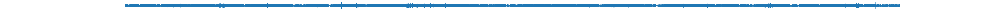

In [86]:
plt.figure(figsize=(180,2))
librosa.display.waveplot(librosa.amplitude_to_db(audio_signal))

<IPython.core.display.Javascript object>


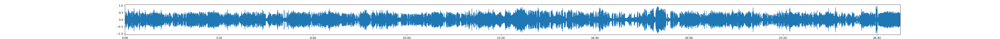

In [78]:
plt.figure(figsize=(50,2))  
librosa.display.waveplot(audio_signal, sample_rate) 
plt.show()

In [37]:
# extract mel spectrogram feature  
melspec = librosa.feature.melspectrogram(audio_signal, sample_rate, n_fft=1024, hop_length=512, n_mels=128)  
# convert to log scale  
logmelspec = librosa.power_to_db(melspec)  
logmelspec.shape

(128, 71038)

<IPython.core.display.Javascript object>


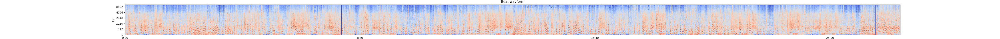

In [77]:
# extract mel spectrogram feature  
melspec = librosa.feature.melspectrogram(audio_signal, sample_rate,  n_fft=1024, hop_length=512, n_mels=128)  
# convert to log scale  
logmelspec = librosa.power_to_db(melspec)  
# plot mel spectrogram  
plt.figure(figsize=(50,2))  
librosa.display.specshow(logmelspec, sr = sample_rate, x_axis='time', y_axis='mel')  
plt.title('Beat wavform')  
plt.show()  

In [62]:
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform

def hs_histograms_similarity(hs_histogram0, hs_histogram1):
  features_distance_metrics = {'intersection_area': lambda u, v: np.sum(np.min([u, v], 0)),
                              'cityblock': 'cityblock',
                              'seuclidean': 'seuclidean',
                              'correlation':'correlation',
                              'chebyshev': 'chebyshev',
                              'euclidean': 'euclidean', } # NB: this is a similarity metric.
  hist = np.matrix([hs_histogram0,hs_histogram1])
  similarity = 1 - pdist(hist, features_distance_metrics['correlation'])
  return similarity


In [66]:
def next_pow_2(x):
    """Smallest next power of two of a given value x."""
    return 1 << (x - 1).bit_length()

In [72]:
def compute_self_similarity(feature_vector_matrix, similarity_function = hs_histograms_similarity):
  # TODO: implement. 
  # For calling the similarity function, you can just use similarity_function(first_vector, second_vector).
  h, w = feature_vector_matrix.shape
  self_similarity = np.zeros((h,h))
  for i in range(h):
    for j in range(h):
      self_similarity[i,j] = similarity_function(feature_vector_matrix[i,:],feature_vector_matrix[j,:])
      
  return self_similarity

In [73]:
audio_frame_size = next_pow_2(int(sample_rate / 4.0))  # i.e., about 0.25 seconds.
audio_hop_size = int(audio_frame_size / 2.0)  # i.e., 50% overlap.
number_of_seconds = librosa.get_duration(audio_signal, sample_rate)

In [74]:
# Extract MFCCs vectors.
mfccs_matrix = librosa.feature.mfcc(audio_signal, n_fft=audio_frame_size, hop_length=audio_hop_size)  # TODO: complete.

# Subsample.
mfccs_matrix_resampled =  np.array(resample(mfccs_matrix.transpose(), number_of_seconds))  # TODO: complete.

print('MFCCs feature matrix size: %d x %d' % np.shape(mfccs_matrix_resampled))

# Remove the full size Chroma matrix (we don't need it anymore).
del mfccs_matrix

MFCCs feature matrix size: 1649 x 20


/usr/local/lib/python3.5/dist-packages/scipy/signal/signaltools.py:1741: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  Y = zeros(newshape, 'D')


In [75]:
mfccs_self_similarity = compute_self_similarity(mfccs_matrix_resampled, similarity_function = hs_histograms_similarity)  # TODO: complete.
print('MFCCs self-similarity matrix size: %d x %d' % np.shape(mfccs_self_similarity))

MFCCs self-similarity matrix size: 1649 x 1649


In [76]:
bokeh_imshow(mfccs_self_similarity)

NameError: name 'bokeh_imshow' is not defined